In [4]:
from load import load_all_sis_data
import numpy as np

# Load all data
all_flux_data, datetime_values, element_mapping = load_all_sis_data('flux_2014/')

print("All data shape:", all_flux_data.shape)
print("Element Mapping:", element_mapping, "\n")

# Precompute the Q1 values for each element
energy_level_to_compute = 1
q1_values = {}
for element_name, element_index in element_mapping.items():
    valid_data_mask = (all_flux_data[energy_level_to_compute - 1, :, element_index] != -999.9) & (all_flux_data[energy_level_to_compute - 1, :, element_index] != 0)
    element_flux_for_stats = all_flux_data[energy_level_to_compute - 1, :, element_index][valid_data_mask]
    if len(element_flux_for_stats) > 0:
        q1_values[element_name] = np.percentile(element_flux_for_stats, 25)

# multiplier for He and O to account for abundance
q1_values["He"] *= 3
q1_values["O"] *= 2.25
print("Q1 Cutoffs: ", q1_values)

# These values will be used as the lower cutoff for decay event identification
he_flux_threshold = q1_values["He"]

All data shape: (8, 91608, 6)
Element Mapping: {'C': 0, 'Fe': 1, 'He': 2, 'N': 3, 'O': 4, 'Si': 5} 

Q1 Cutoffs:  {'C': 8.3286e-06, 'Fe': 3.5479e-06, 'He': 8.335800000000001e-05, 'N': 7.4143e-06, 'O': 1.522125e-05, 'Si': 4.9786e-06}



---

The `compute_decay_events_for_all_data` function utilizes the `identify_exponential_decays` function to find decay events within the entire data range (2014 to 2024) based on Helium flux at an energy level defined by `energy_level_to_compute`. The computed event windows are then stored in a Pandas dataframe. Keeps only events that are longer than the defined hours **and** where the helium (reference) flux stays above the threshold for the specified duration, then disregards the rest.

Then, for each of the other elements, the `count_elements_decaying_in_window` function determines whether or not it is also decaying within the event window, and appends two columns to the dataframe.

Currently, `he_flux_threshold` is defined as 3 times the Q1 upper bound for helium flux data

In [5]:
import pandas as pd
from identification import compute_decay_events_for_all_data

# Define parameters for decay detection and event counting
energy_level_to_compute = 1
min_duration_hours = 48
window_size = 24  # hours for detecting decays in He flux
window_size_for_decay_count = 18  # hours for counting decaying elements
slope_threshold = -0.005
r_value_threshold = 0.0

# Compute decay events using the defined parameters
decay_events_df = compute_decay_events_for_all_data(all_flux_data, datetime_values, element_mapping, energy_level_to_compute, he_flux_threshold, min_duration_hours, window_size, window_size_for_decay_count, slope_threshold, r_value_threshold)

# Fix columns from wrapping
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)
pd.set_option('display.colheader_justify', 'center')

# Print and save the decay events DataFrame
print(decay_events_df)
decay_events_df.to_csv('transformed_data/uncleaned_decay_events_14.csv', index=False)

     Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0           1         2014       2014           1.000000             4.958333        0.000000  23.000000          1            [C, Si, O, N, Fe] 
1           3         2014       2014           8.833333            20.750000       20.000000  18.000000          6                           [] 
2           4         2014       2014          21.333322            25.041667        7.999722   1.000000          1            [C, Si, O, N, Fe] 
3           5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [C, Si, O, N, Fe] 
4           7         2014       2014          35.833333            39.499988       20.000000  11.999722          1            [C, Si, O, N, Fe] 
..            ...         ...       ...                   ...                 ...         ...        ...                ... 

Code below plots a histogram of the number of elements decaying per event found. It seems like He-only events make up the vast majority of events identified, but this might be due to bias caused by using He as the reference element when determining cutoffs, as well as He being much more abundnant.

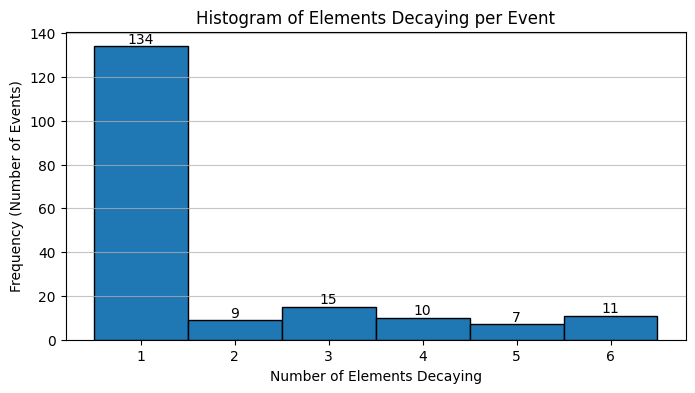

In [6]:
import pandas as pd
import matplotlib.pyplot as plt

# Plotting the histogram
plt.figure(figsize=(8, 4))
counts, bins, patches = plt.hist(decay_events_df['Elements Decaying'], bins=range(1, decay_events_df['Elements Decaying'].max() + 2), align='left', edgecolor='black')
plt.title('Histogram of Elements Decaying per Event')
plt.xlabel('Number of Elements Decaying')
plt.ylabel('Frequency (Number of Events)')
plt.xticks(range(1, decay_events_df['Elements Decaying'].max() + 1))
plt.grid(axis='y', alpha=0.75)

# Annotating the bars with their frequencies
for count, bin_edge in zip(counts, bins):
    if count > 0:
        plt.text(bin_edge, count, f'{int(count)}', ha='center', va='bottom')

plt.show()


Code below plots a grid of all the decay events found. Currently commented out because it takes a long time to run due to the large number of events.

In [5]:
from graph import plot_all_decay_events

energy_level_to_plot = 1
extend_days = 1  # Adjust the number of days to extend before and after
print(f"Graph of flux events using data from energy level {energy_level_to_plot} and using data from Helium at energy level {energy_level_to_compute} for cutoffs")
# plot_all_decay_events(decay_events_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

Graph of flux events using data from energy level 1 and using data from Helium at energy level 1 for cutoffs


Code below filters out bad decay events to be used for training a classifier. This dataset specificially is hand picked.

    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [C, Si, O, N, Fe] 
1         25         2014       2014         192.833333           195.583322       20.000000  13.999722          1            [C, Si, O, N, Fe] 
2         37         2014       2014         286.000000           289.749988        0.000000  17.999722          1            [C, Si, O, N, Fe] 
3         38         2014       2014         292.333333           294.791667        8.000000  19.000000          2               [C, N, Fe, Si] 
4         42         2014       2014         327.791655           329.875000       18.999722  21.000000          1            [C, Si, O, N, Fe] 
5         55         2015       2015          35.999988            38.374988       23.999722   8.999722          1            [C, 

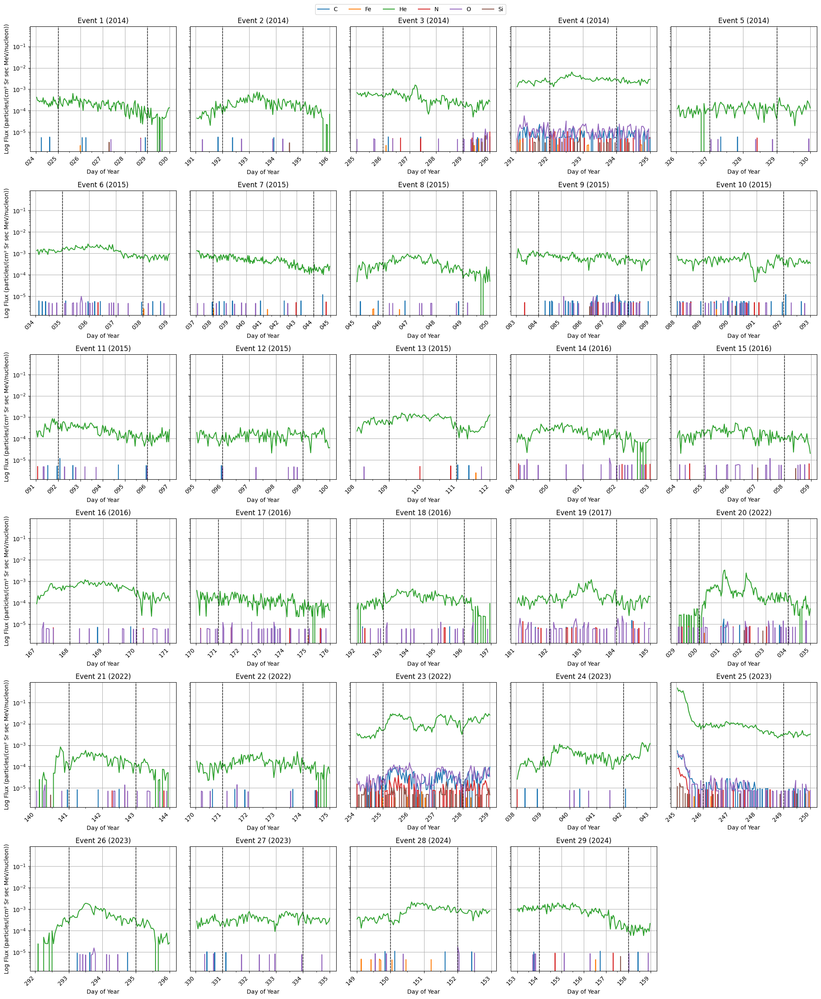

In [9]:
import pandas as pd
from graph import plot_all_decay_events

indices_to_keep = [3, 16, 23, 24, 28, 35, 36, 37, 41, 42, 43, 44, 46, 64, 65, 69, 70, 71, 86, 108, 117, 119, 124, 136, 153, 159, 163, 183, 184]
bad_df = decay_events_df.iloc[indices_to_keep]
bad_df.reset_index(drop=True, inplace=True)

energy_level_to_plot = 1
extend_days = 1  # Adjust the number of days to extend before and after

print(bad_df)
plot_all_decay_events(bad_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

Code below utilizes plotly to plot an interactive plot of all flux data and overlays general events identified from the data

In [7]:
import pandas as pd
from graph import create_interactive_plot_with_events

energy_level_to_plot = 1
start_time = pd.to_datetime('2014-01-01')
end_time = pd.to_datetime('2024-12-31')
output_html = 'web_plot.html'  

create_interactive_plot_with_events(all_flux_data, datetime_values, element_mapping, energy_level_to_plot, start_time, end_time, output_html, decay_events_df)


c:\Users\jeffr\AppData\Local\Programs\Python\Python311\Lib\site-packages\plotly\io\_json.py:560: UserWarning:

Discarding nonzero nanoseconds in conversion.



Next, we filter by events that have at least 4/6 elements decaying or more. These 27 events will be used to train the classifier as well

    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          3         2014       2014           8.833333            20.750000       20.000000  18.000000          6                      []      
1         12         2014       2014          59.458333            74.833333       11.000000  20.000000          6                      []      
2         18         2014       2014         109.625000           117.875000       15.000000  21.000000          4                [Fe, Si]      
3         29         2014       2014         250.750000           254.083333       18.000000   2.000000          4                [Fe, Si]      
4         30         2014       2014         255.041667           263.416655        1.000000   9.999722          4                 [N, Si]      
5         40         2014       2014         306.000000           312.791655        0.000000  18.999722          5                

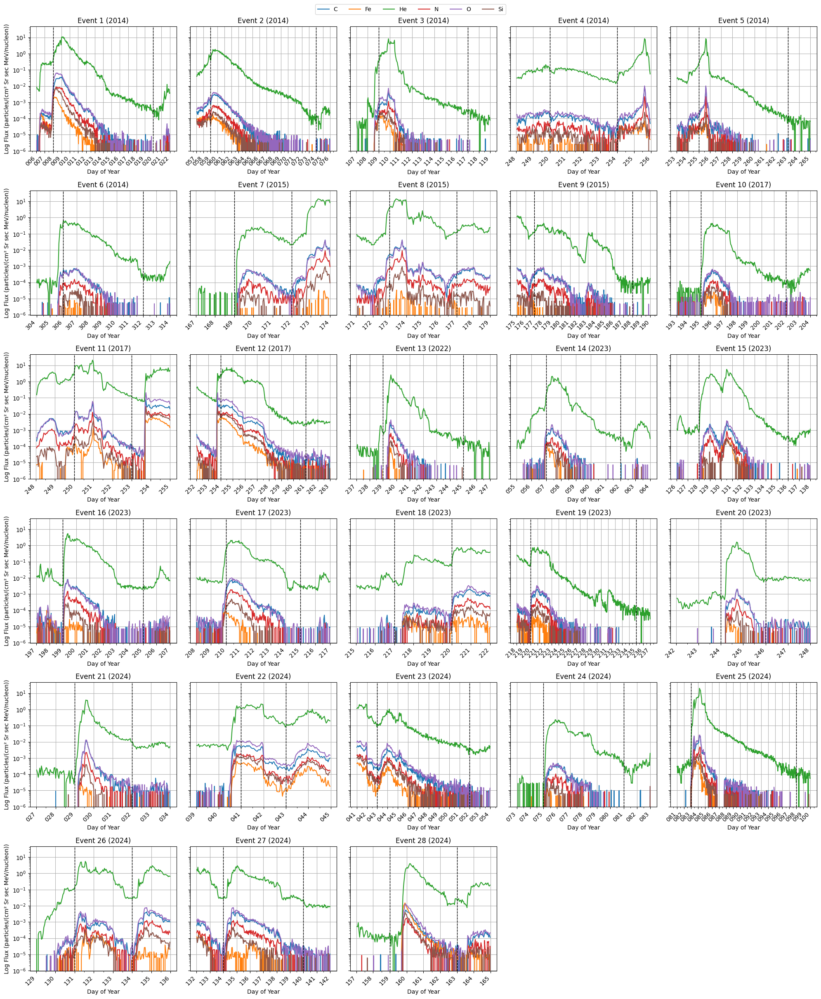

In [10]:
def filter_by_elements_decaying(decay_events_df, min_elements_decaying_list):
    # Filter the DataFrame based on any of the minimum thresholds
    filtered_df = decay_events_df[decay_events_df['Elements Decaying'].isin(min_elements_decaying_list)]

    # Reset the index of the filtered DataFrame
    filtered_df = filtered_df.reset_index(drop=True)
    return filtered_df

min_elements_decaying_list = [4,5,6]  # Set the thresholds for elements decaying
filtered_df = filter_by_elements_decaying(decay_events_df, min_elements_decaying_list)

print(filtered_df)
filtered_df.to_csv('transformed_data/filtered_decay_events.csv', index=False)

#Plot filtered events
from graph import plot_all_decay_events

energy_level_to_plot = 1
extend_days = 2  # Adjust the number of days to extend before and after
print(f"Graph of flux events using data from energy level {energy_level_to_plot} and using data from Helium at energy level {energy_level_to_compute} for cutoffs")
plot_all_decay_events(filtered_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

Code below plots the 27 events identified above with a new graphing function capable of graphing events by element with individual energy levels. Currently commented out since it takes a while to run.

In [11]:
from graph import plot_decay_events_per_element

# Parameters
energy_levels_to_plot = 5  # Number of lowest energy levels to plot
extend_days = 2  # Extend the time range by 2 days before and after the event
useLogScale = True  # Whether to use a logarithmic scale for the y-axis

# Plot the decay events
#plot_decay_events_per_element(filtered_df, all_flux_data, datetime_values, element_mapping, energy_levels_to_plot, extend_days, useLogScale)


Code below simply combines the false (no decay) and true (yes decay) events into a single df for processing

In [11]:
import pandas as pd

raw_combined_df = pd.concat([bad_df, filtered_df], ignore_index=True)
print(raw_combined_df)

    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [Si, N, Fe, C, O] 
1         25         2014       2014         192.833333           195.583322       20.000000  13.999722          1            [Si, N, Fe, C, O] 
2         37         2014       2014         286.000000           289.749988        0.000000  17.999722          1            [Si, N, Fe, C, O] 
3         38         2014       2014         292.333333           294.791667        8.000000  19.000000          2               [C, Si, N, Fe] 
4         42         2014       2014         327.791655           329.875000       18.999722  21.000000          1            [Si, N, Fe, C, O] 
5         55         2015       2015          35.999988            38.374988       23.999722   8.999722          1            [Si,

Code below uses the `create_dataframe` function found in `features.py` to calculate features from the dataframe of good and bad events, and assigns a target label. The output csv `decay_input_features_2014.csv` will be used as input to train the MLP classifier.

In [12]:
import numpy as np
import pandas as pd
from features import create_dataframe

element_energy_decay_df = create_dataframe(filtered_df, datetime_values, all_flux_data, element_mapping, 1)
bad_element_energy_decay_df = create_dataframe(bad_df, datetime_values, all_flux_data, element_mapping, 0)

combined_df = pd.concat([element_energy_decay_df, bad_element_energy_decay_df], ignore_index=True)

# Shuffle the rows randomly
shuffled_indices = np.random.permutation(combined_df.index)
combined_df = combined_df.reindex(shuffled_indices).reset_index(drop=True)

combined_df.to_csv("transformed_data/decay_input_features_2014.csv", index=False)
print(combined_df)


      Event ID  Element  Duration  Max Flux  Initial Decay Rate  Average Decay Rate  Time to Peak  Peak Prominence  Number of Peaks  Skewness  Kurtosis     Std Flux    Median Flux  Normalized Time to Peak  Decay Rate 25%  Decay Rate 50%  Decay Rate 75%  Avg Decay Percentages  Target Label
0         70       3         72    0.000000       0.000000          0.000000e+00           0          0.000000             0              NaN        NaN  0.000000e+00   0.000000           0.000000           0.000000e+00    0.000000e+00    0.000000e+00       0.000000e+00             0     
1         83       4        263    0.000889      -0.000019          1.390875e-06          23          0.000889            66         2.224136   4.074114  1.973568e-04   0.000014           0.087452           3.664943e-06    2.781749e-06    1.854499e-06       2.767064e-06             1     
2        267       4         48    0.002040      -0.000017         -3.014792e-07          17          0.002040            10      